### Loading pics

In [17]:
import cv2
import numpy as np
import pandas as pd
import sys
import os
import itertools
from IPython.display import Image
import matplotlib.pyplot as plt
from PIL import Image 
from IPython.display import Image

In [18]:
os.getcwd()

'/Users/saruul/Desktop/openCV'

In [19]:
print(os.listdir())
print(os.getcwd())

['cat_domestic_cat_sweet.jpg', 'Eid mubarak islamic greeting with mosque silhouette.jpg', '.DS_Store', 'pexels-sultan-raimosan-6543272.jpg', 'cat1.png', 'air_force_lockheed_pv1.jpg', 'MyOwnPersonalization.ipynb', 'circle.jpg', 'pexels-jhon-ferreira-15270018.jpg', 'coca-cola-logo.png', 'elephant_with_stick_196492.jpg', 'checkerboard_18x18.png', 'eiffel_tower_france_paris.jpg', 'Mungunzorig Saruul work report.docx', 'Basics_FollowUp.ipynb', '.ipynb_checkpoints', 'ColoredImages', '.git', 'earth_blue_planet_globe.jpg', 'DIP3E_Original_Images_CH01', 'checkerboard_color.png']
/Users/saruul/Desktop/openCV


In [20]:
dir_path = "/Users/saruul/Desktop/openCV/DIP3E_Original_Images_CH01"

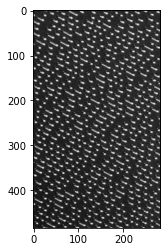

In [21]:
grey_pic_files = []
for i, filename in enumerate(os.listdir(dir_path)):
    if filename.endswith(".tif"):
        if i >= 10:
            break
        img_path = os.path.join(dir_path, filename)
        grey_pic_files.append(img_path)
        for pic in grey_pic_files:
            img = cv2.imread(pic)
            plt.imshow(img)

In [22]:
dir_path = "/Users/saruul/Desktop/openCV/ColoredImages"

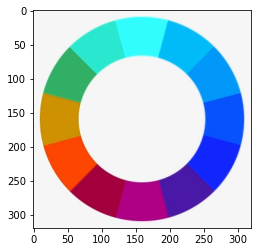

In [23]:
colored_pic_files = []
for i, filename in enumerate(os.listdir(dir_path)):
    if filename.endswith(".png"):
        if i >= 10:
            break
        img_path = os.path.join(dir_path, filename)
        colored_pic_files.append(img_path)
        for pic in colored_pic_files:
            img = cv2.imread(pic)
            plt.imshow(img)

# Resize with different interpolations techniques

What is the interpolation when used for resizing ? 
cv2.resize(src, dsize[, dst[, fx[, fy[, interpolation]]]])
- fx: scale factor along the horizontal axis
- fy: scale factor along the vertical axis
- interpolation: Interpolation is a method that decides which pixel gets which value based on its neighboring pixels and the scale at which the image is being resized. 
    - INTER_NEAREST: selects the nearest pixel from the original image as the new pixel value. It is the fastest but can result in a loss of detail and sharpness.
    - INTER_LINEAR: calculates the new pixel value as a weighted average of the surrounding four pixels in the original image. It produces smoother results than the nearest neighbor method but can still result in some loss of detail
    - INTER_AREA: calculates by averaging the pixel values in the original image that correspond to each pixel in the resized image, good choice when you want to reduce the size of an image while minimizing the loss of information and preserving the quality of the image.
    - INTER_CUBIC: calculates the new pixel value as a weighted average of the surrounding 16 pixels in the original image. It produces even smoother results than linear interpolation but can take longer to compute.
    - INTER_LANCZOS4: calculates the new pixel value as a weighted average of the surrounding 16 pixels in the original image, with a weighting function that emphasizes the central pixel. It produces the smoothest results of all the interpolation methods but can be the slowest to compute.
    
    
There are 3 ways to resize the image:
- Preserve the Aspect Ratio and increase or decrease the width and height of the image. Aspect Ratio is the ratio of image width to image height.
- Scale the image only along X-axis or Horizontal axis. Meaning, change width, keeping height same as that of original image
- Scale the image only along Y-axis or Vertical axis. Meaning, change height, keeping width same as that of original image.

(6000, 4000, 3)


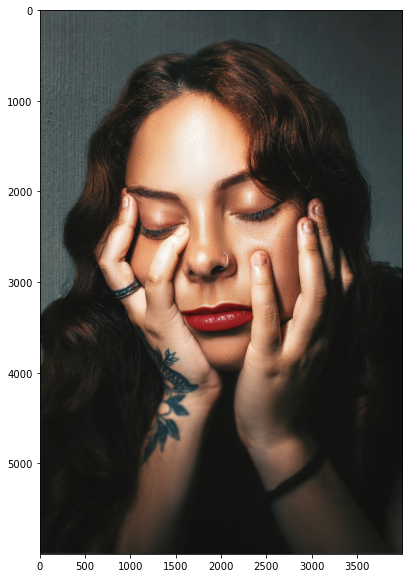

In [24]:
color_im0 = cv2.imread("/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg",1)[:, :, ::-1]
print(color_im0.shape)
plt.figure(figsize=[15,10])
plt.imshow(color_im0)

In [25]:
scale_percent = 50
width = int(color_im0.shape[1] * scale_percent / 100)
height = int(color_im0.shape[0] * scale_percent / 100)
dim = (width, height)

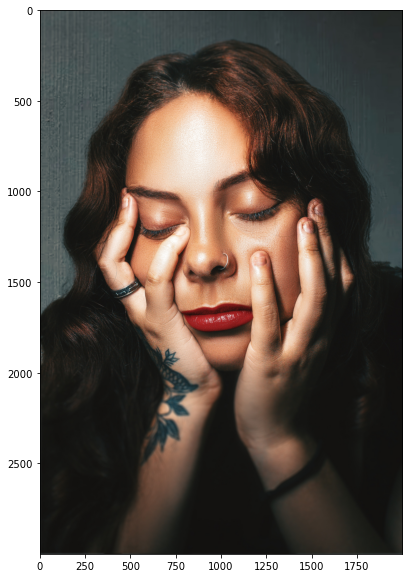

In [26]:
inter_area = cv2.resize(color_im0, dsize=dim, interpolation=cv2.INTER_AREA)
plt.figure(figsize=[15,10])
plt.imshow(inter_area)

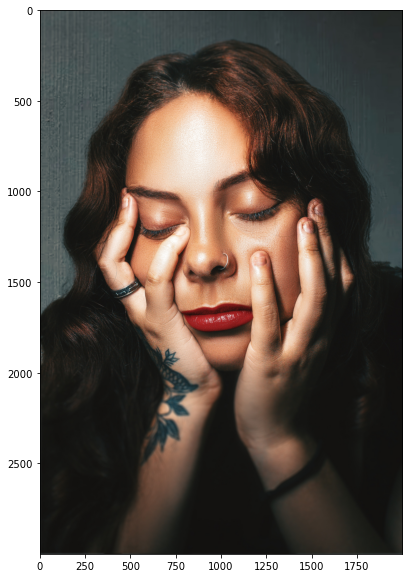

In [27]:
inter_linear = cv2.resize(color_im0, dsize=dim, interpolation=cv2.INTER_LINEAR)
plt.figure(figsize=[15,10])
plt.imshow(inter_linear)

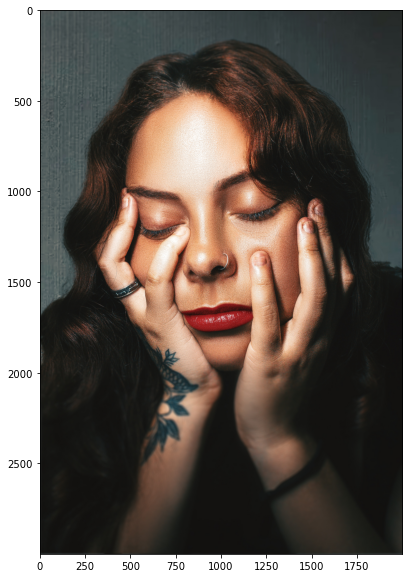

In [28]:
inter_nearest = cv2.resize(color_im0, dsize=dim, interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=[15,10])
plt.imshow(inter_nearest)

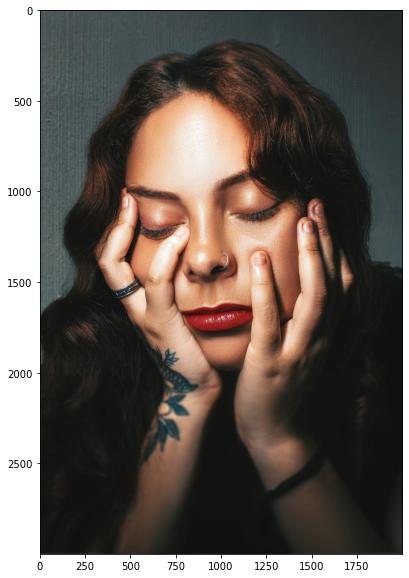

In [29]:
inter_cubic = cv2.resize(color_im0, dsize=dim, interpolation=cv2.INTER_CUBIC)
plt.figure(figsize=[15,10])
plt.imshow(inter_cubic)

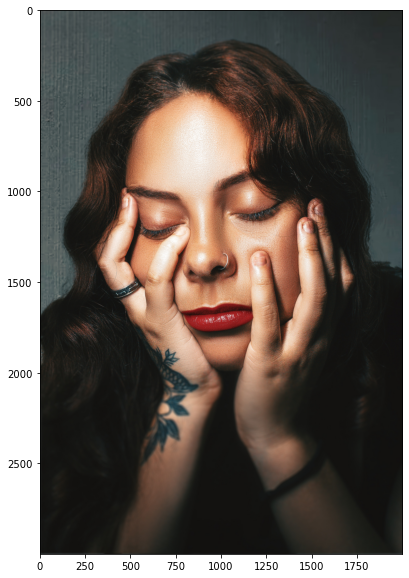

In [30]:
inter_lanczo = cv2.resize(color_im0, dsize=dim, interpolation=cv2.INTER_LANCZOS4)
plt.figure(figsize=[15,10])
plt.imshow(inter_lanczo)

Text(0.5, 1.0, 'inter_linear')

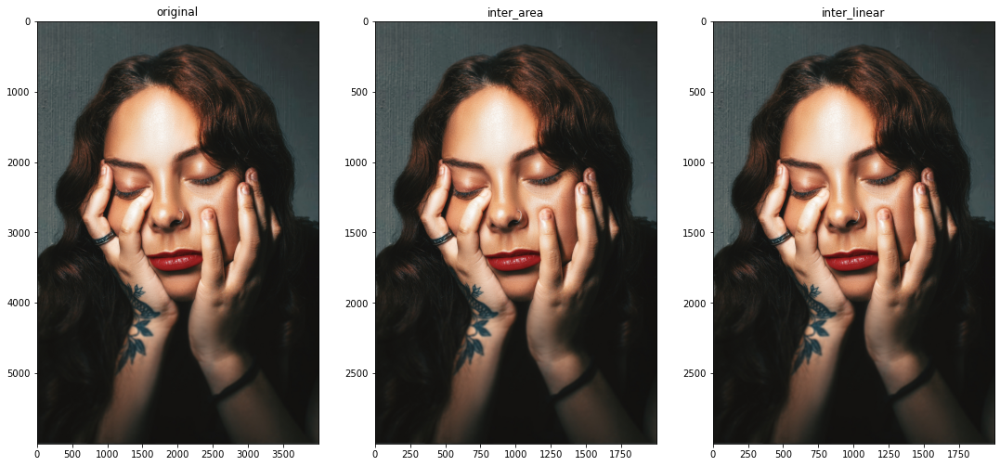

In [31]:
plt.figure(figsize=[25,15])
plt.subplot(141); plt.imshow(color_im0); plt.title("original")
plt.subplot(142); plt.imshow(inter_area); plt.title("inter_area")
plt.subplot(143); plt.imshow(inter_linear); plt.title("inter_linear")
# plt.subplot(144); plt.imshow(inter_nearest)
# plt.subplot(144); plt.imshow(inter_cubic)
# plt.subplot(146); plt.imshow(inter_lanczo)

Text(0.5, 1.0, 'inter_cubic')

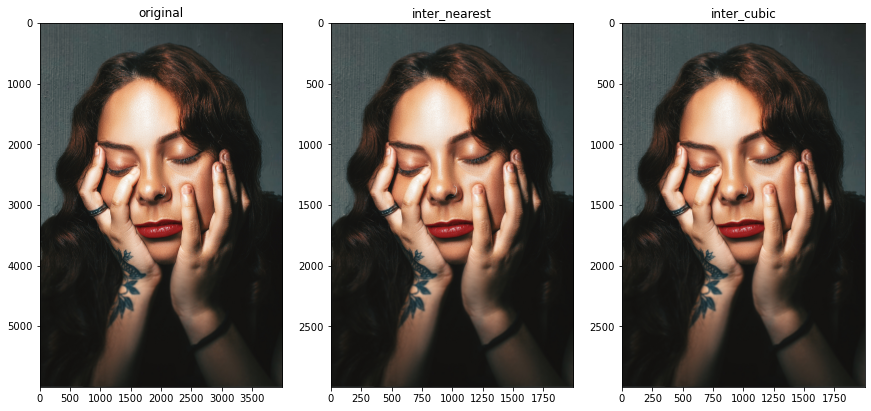

In [32]:
plt.figure(figsize=[20,10])
plt.subplot(141); plt.imshow(color_im0); plt.title("original")
plt.subplot(142); plt.imshow(inter_nearest); plt.title("inter_nearest")
plt.subplot(143); plt.imshow(inter_cubic); plt.title("inter_cubic")
# plt.subplot(144); plt.imshow(inter_lanczo); plt.title("inter_lanczo")

Text(0.5, 1.0, 'inter_lanczo')

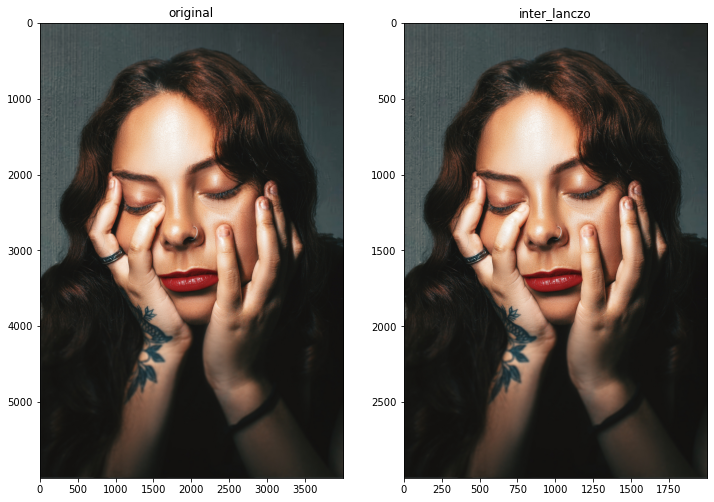

In [33]:
plt.figure(figsize=[25,15])
plt.subplot(141); plt.imshow(color_im0); plt.title("original")
plt.subplot(142); plt.imshow(inter_lanczo); plt.title("inter_lanczo")

Observations
- To resize the source image, image interpolation techniques uses nearby pixels. The INTER AREA approach, which uses all of the pixels for scaling as opposed to other methods that use the nearby pixels, is the best at maintaining the image quality. The weighting function of INTER LANCZOS4 emphasizes core pixels, which makes it effective in preventing loss. The ways that are shown below are displayed best to follow at image loss prevention but depending on the purpose, one may be more appropriate than another, such as the fastest method that involves the nearest neighbor.

INTER_AREA > INTER_LANCZOS4 > INTER_CUBIC >= INTER_LINEAR >= INTER_NEAREST


# Loop circles and find relative path

(1800, 1800, 3)


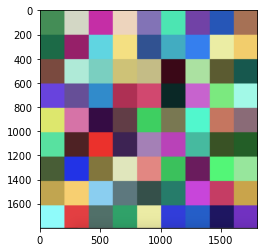

In [34]:
rectangle = cv2.imread("/Users/saruul/Desktop/openCV/checkerboard_color.png",1)
print(rectangle.shape)
plt.imshow(rectangle)

(1800, 1800, 3)

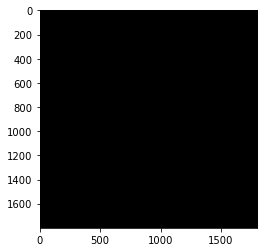

In [35]:
rectangle = np.zeros(rectangle.shape)
plt.imshow(rectangle[:, :, ::-1])
rectangle.shape

In [36]:
cv2.circle(rectangle, (900,600), 300, (255, 0, 127), thickness=10);
rectangle = cv2.line(rectangle, (900, 600), (900, 1500), (0, 128, 0), thickness=20)
# plt.figure(figsize=[10,10])
# plt.imshow(rectangle)

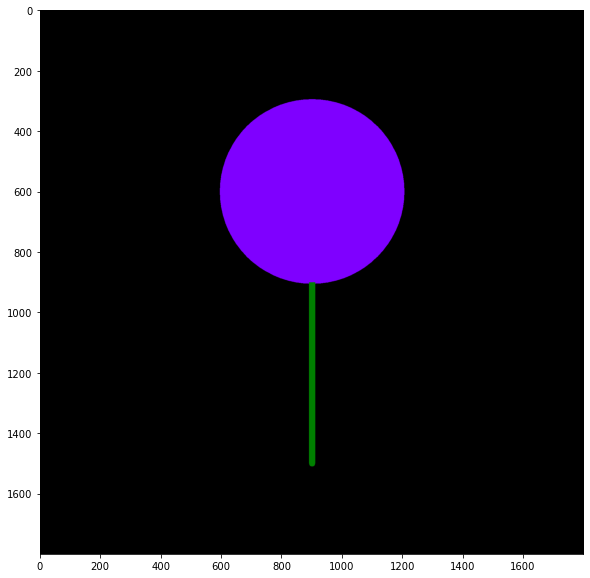

In [37]:
r = 300
for i in range(0,40):
    r=r-10
    if r == 0:
        break
    cv2.circle(rectangle, (900,600), r, (255, 0, 127), thickness=20)
plt.figure(figsize=[10,10])
plt.imshow(np.uint8(np.clip(rectangle, 0, 255))[:, :, ::-1])

In [38]:
import math
pi = math.pi
n = 20
r = 50
pnts = []

for x in range(0,n+1):
    x_a = 900 + math.cos(2*pi/n*x)*r
    y_a = 600 + math.sin(2*pi/n*x)*r
    pnts.append((x_a, y_a))

pnts =[tuple(i) for i in pnts]

for x,y in pnts:
    cv2.circle(rectangle, (int(x),int(y)), 50, (0, 0, 255), thickness=10, lineType=cv2.LINE_AA);    

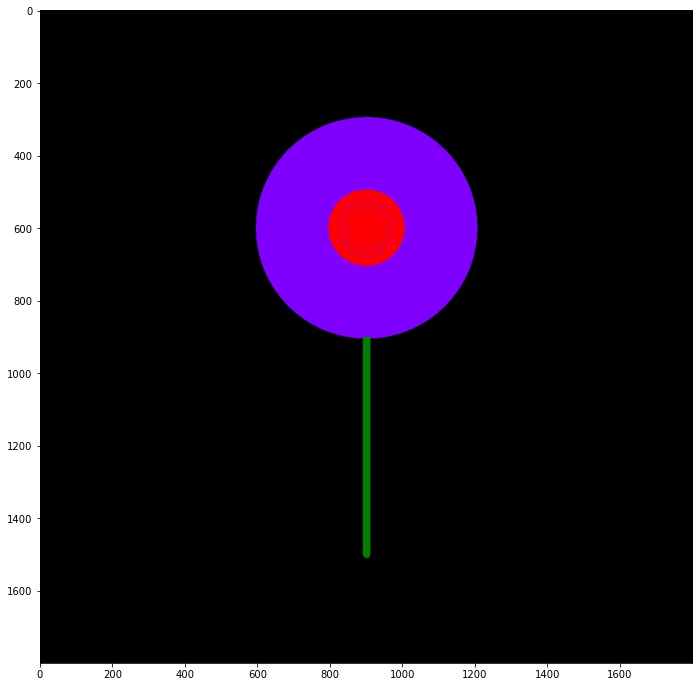

In [39]:
plt.figure(figsize=[12,12])
plt.imshow(np.uint8(np.clip(rectangle, 0, 255))[:, :, ::-1])

In [40]:
import math
pi = math.pi
n = 5
r = 200
pnts = []

for x in range(0,n+1):
    x_a = 900 + math.cos(2*pi/n*x)*r
    y_a = 600 + math.sin(2*pi/n*x)*r
    pnts.append((x_a, y_a))

pnts =[tuple(i) for i in pnts]

for x,y in pnts:
    cv2.circle(rectangle, (int(x),int(y)), 150, (0, 153, 0), thickness=50, lineType=cv2.LINE_AA);    

In [41]:
import math
pi = math.pi
n = 20
r = 300
pnts = []

for x in range(0,n+1):
    x_a = 900 + math.cos(2*pi/n*x)*r
    y_a = 600 + math.sin(2*pi/n*x)*r
    pnts.append((x_a, y_a))

pnts =[tuple(i) for i in pnts]

for x,y in pnts:
    cv2.circle(rectangle, (int(x),int(y)), 50, (0, 0, 255), thickness=5, lineType=cv2.LINE_AA);    

In [42]:
for x,y in pnts:
    for l in range(1,50,10):
        cv2.circle(rectangle, (int(x),int(y)), l, (0, 0, 255), thickness=5, lineType=cv2.LINE_AA);    

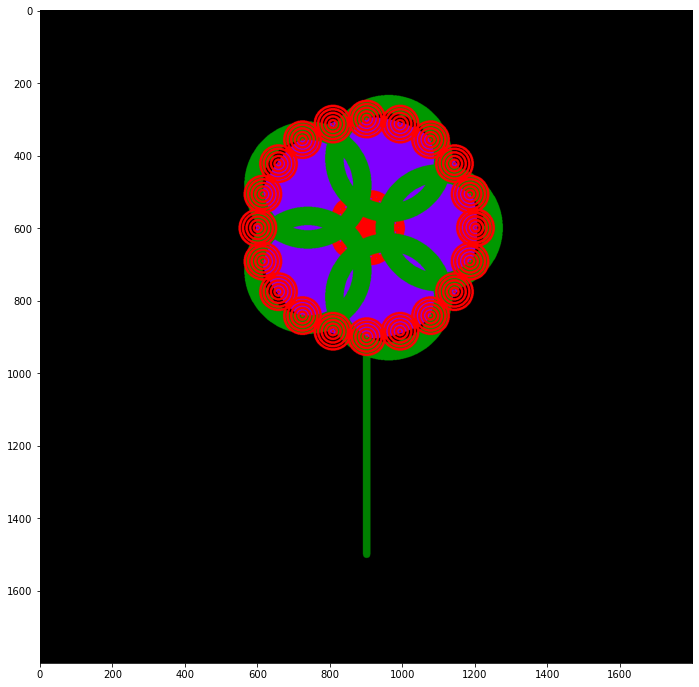

In [43]:
plt.figure(figsize=[12,12])
plt.imshow(np.uint8(np.clip(rectangle, 0, 255))[:, :, ::-1])

In [44]:
a = 800
b =1300
c =1000
d =1600
for i in zip(range(1,50)):
    a = a + 5
    b = b + 5
    c = c - 5
    d = d - 5
    cv2.rectangle(rectangle, (a, b), (c, d), (165,42,42), thickness=10, lineType=cv2.LINE_8);

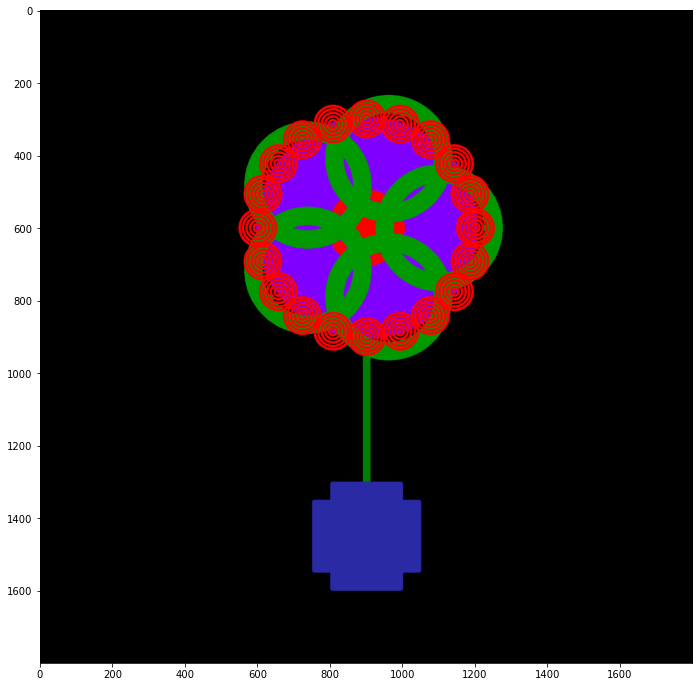

In [45]:
plt.figure(figsize=[12,12])
plt.imshow(np.uint8(np.clip(rectangle, 0, 255))[:, :, ::-1])

# Move flower and calculate the root coordinates of the drawn object

Root coordinate is the top-left corner (0,0). I think, to find the root coordinate of the drawn shape in a image, must find the smallest rectangular that containing the drawn shape.

In this case, finding non-zero elements and find the smallest rectangular which containing non-zero elements. 


In [116]:
indices = np.transpose(np.nonzero(rectangle))

min_row = np.min(indices[:, 0])
max_row = np.max(indices[:, 0])
min_col = np.min(indices[:, 1])
max_col = np.max(indices[:, 1])
width = max_col - min_col + 1
height = max_row - min_row + 1
shape = (height, width)
print("Shape of an smallest rectangular that containing flower:" ,shape)

Shape of an smallest rectangular that containing flower: (1367, 729)


In [120]:
root = (np.min(indices[:, 0]), np.min(indices[:, 1]))
print("Top-left, root coordinate of rectangular that containing flower:", root)

Top-left, root coordinate of rectangular that containing flower: (234, 547)


### Move the flower

To move the flower, I will use Affine transformation.

In [121]:
height, width = rectangle.shape[:2]
angle = 45
M = cv2.getRotationMatrix2D((width/2, height/2), angle, 1)
rotated_img = cv2.warpAffine(rectangle, M, (width, height))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'rotated')

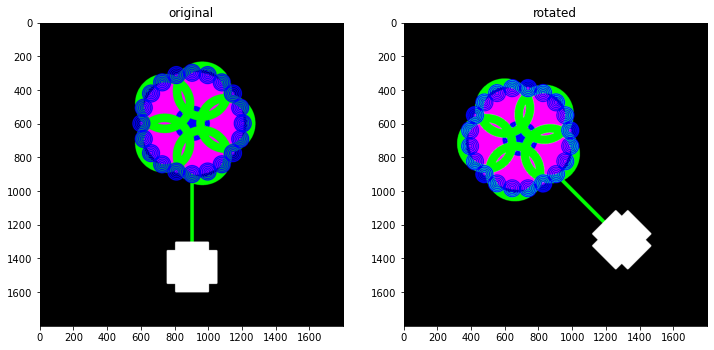

In [123]:
plt.figure(figsize=[25,15])
plt.subplot(141); plt.imshow(rectangle); plt.title("original")
plt.subplot(142); plt.imshow(rotated_img); plt.title("rotated")

In [127]:
tx = 400
ty = 200
M = np.float32([[1, 0, tx], [0, 1, ty]])
translated_img = cv2.warpAffine(rectangle, M, (width, height))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'translated')

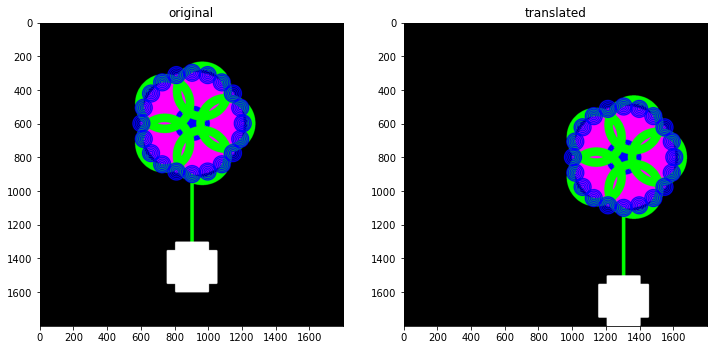

In [129]:
plt.figure(figsize=[25,15])
plt.subplot(141); plt.imshow(rectangle); plt.title("original")
plt.subplot(142); plt.imshow(translated_img); plt.title("translated")

# Color manipulation using math operations

- When a pixel value becomes less than 0, it is considered "underflow"
- When a pixel value becomes greater than 255, it is considered "overflow"

When using openCV's inline functions, openCV automatically adjusts the value between [0,255] according to RGB.

In [140]:
melody = cv2.imread("cat1.png",1)[:, :, ::-1]

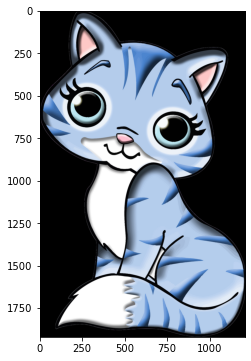

In [143]:
plt.figure(figsize=[8,6])
plt.imshow(melody)

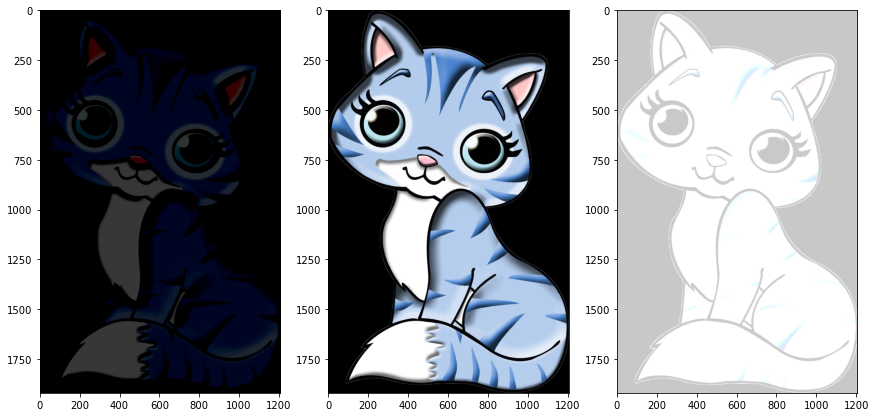

In [144]:
matrix = np.ones(melody.shape, dtype = "uint8") * 200

img_rgb_brighter = cv2.add(melody, matrix)
img_rgb_darker   = cv2.subtract(melody, matrix)

plt.figure(figsize=[25,10])
plt.subplot(151); plt.imshow(img_rgb_darker); 
plt.subplot(152); plt.imshow(melody);   
plt.subplot(153); plt.imshow(img_rgb_brighter);


In [146]:
melody.shape

(1920, 1207, 3)

In [147]:
img_rgb_brighter.shape

(1920, 1207, 3)

In [155]:
print(melody.max())
print(melody.min())
print(melody.mean())

print(img_rgb_brighter.max())
print(img_rgb_brighter.min())
print(img_rgb_brighter.mean())

255
0
106.62197324058731
255
90
173.49707148117463


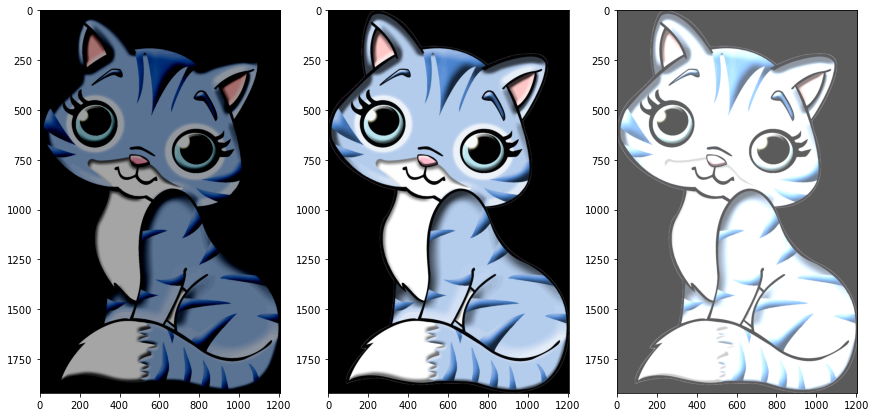

In [154]:
matrix = np.ones(melody.shape, dtype = "uint8") * 90

img_rgb_brighter = cv2.add(melody, matrix)
img_rgb_darker   = cv2.subtract(melody, matrix)

plt.figure(figsize=[25,10])
plt.subplot(151); plt.imshow(img_rgb_darker); 
plt.subplot(152); plt.imshow(melody);   
plt.subplot(153); plt.imshow(img_rgb_brighter);

In [156]:
print(melody.max())
print(melody.min())
print(melody.mean())

print(img_rgb_brighter.max())
print(img_rgb_brighter.min())
print(img_rgb_brighter.mean())

255
0
106.62197324058731
255
90
173.49707148117463


In [159]:
woman = cv2.imread("/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg",1)[:, :, ::-1]

In [164]:
woman.shape

(6000, 4000, 3)

In [165]:
matrix1 = np.ones(cv2.imread("/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg", 1).shape) * .8
matrix2 = np.ones(cv2.imread("/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg", 1).shape) * 1.2

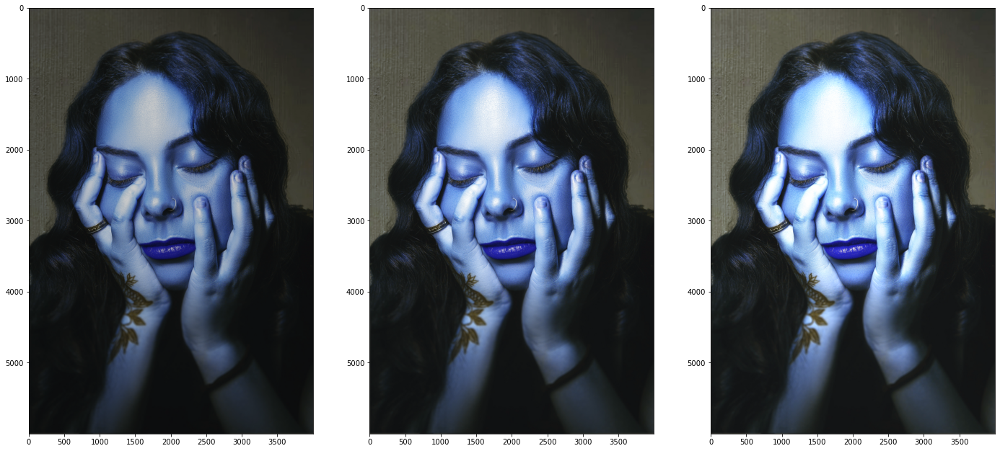

In [168]:
img_rgb_lower   = np.uint8(cv2.multiply(np.float64(cv2.imread("/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg", 1)), matrix1))
img_rgb_higher  = np.uint8(np.clip(cv2.multiply(np.float64(cv2.imread("/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg", 1)), matrix2),0,255))

plt.figure(figsize=[24,15])
plt.subplot(131); plt.imshow(img_rgb_lower); 
plt.subplot(132); plt.imshow(cv2.imread("/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg", 1));       
plt.subplot(133); plt.imshow(img_rgb_higher);

In [169]:
print(img_rgb_lower.max())
print(img_rgb_lower.min())
print(img_rgb_lower.mean())

print(img_rgb_higher.max())
print(img_rgb_higher.min())
print(img_rgb_higher.mean())

204
0
53.9192065
255
0
79.31327418055555


# Masks and bitwise different operations

Masking in image processing is a technique where a binary mask is used to filter or modify specific regions of an image. A binary mask is a grayscale image where the pixel values are either 0 or 1. A pixel with a value of 0 is considered to be part of the background, while a pixel with a value of 1 is considered to be part of the foreground.

Masking can be used to accomplish a variety of image processing tasks, such as:

- Image segmentation: separating the foreground and background regions of an image
- Object detection: identifying and locating specific objects within an image
- Image blending: combining multiple images into a single image
- Image enhancement: improving the quality or appearance of an image by modifying specific regions
Here are some common options for masking in image processing:

- Thresholding: converting a grayscale image to a binary mask by setting all pixels above or below a threshold value to 1 or 0, respectively.
- Morphological operations: applying a set of operations, such as erosion or dilation, to modify the shape and size of the foreground and background regions in the binary mask.
- Contour detection: detecting the contours, or edges, of the foreground regions in the binary mask.
- Region of interest (ROI) selection: selecting specific regions of an image based on a predefined shape, such as a rectangle or polygon, to create a binary mask that filters out the background regions outside of the ROI.
- Alpha channel: creating an alpha channel that specifies the opacity or transparency of each pixel in the image, allowing for more precise masking and blending of images.

In [ ]:
img = cv2.imread('cat1.png')

mask1 = np.zeros(img.shape[:2], dtype=np.uint8)
mask2 = np.zeros(img.shape[:2], dtype=np.uint8)

cv2.circle(mask1, (200, 200), 500, 255, -1)
cv2.circle(mask2, (800, 800), 300, 255, -1)

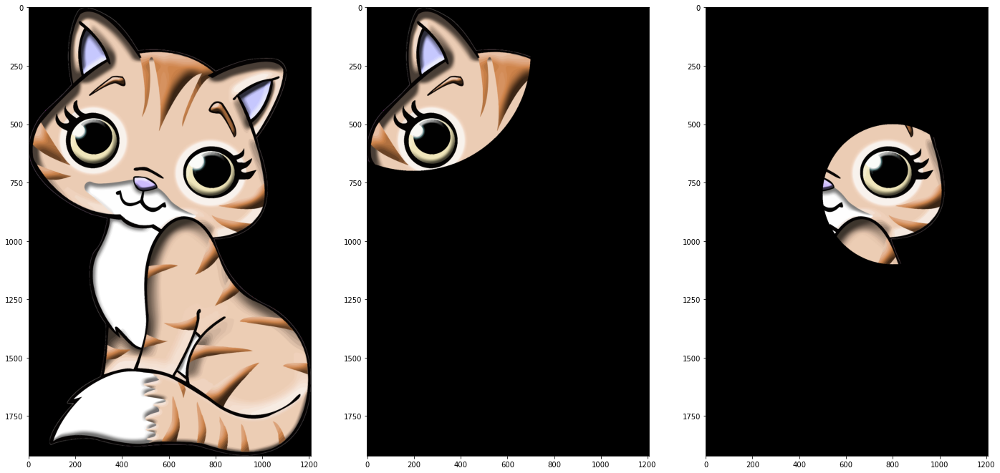

In [182]:
masked_img1 = cv2.bitwise_and(img, img, mask=mask1)
masked_img2 = cv2.bitwise_and(img, img, mask=mask2)

plt.figure(figsize=[24,15])
plt.subplot(131); plt.imshow(img)
plt.subplot(132); plt.imshow(masked_img1)
plt.subplot(133); plt.imshow(masked_img2)

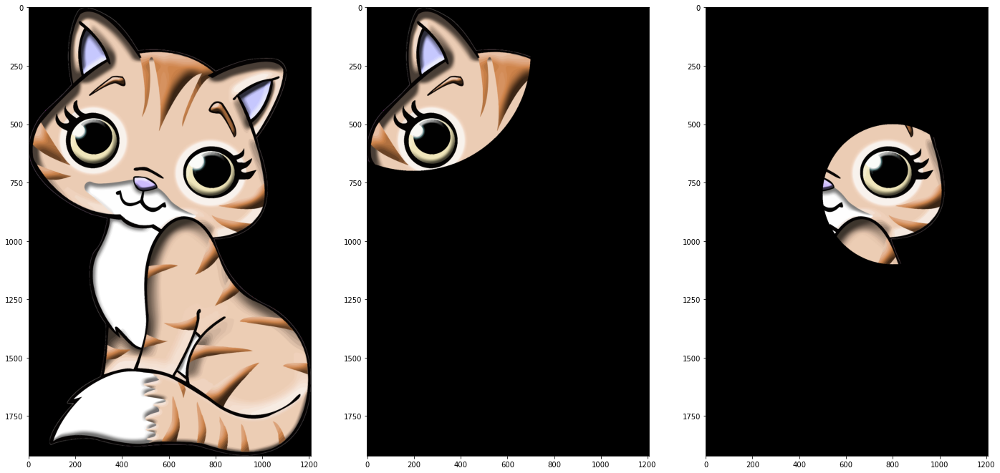

In [181]:
masked_img1 = cv2.bitwise_or(img, img, mask=mask1)
masked_img2 = cv2.bitwise_or(img, img, mask=mask2)

plt.figure(figsize=[24,15])
plt.subplot(131); plt.imshow(img)
# plt.subplot(132); plt.imshow(mask1)
# plt.subplot(133); plt.imshow(mask2)
plt.subplot(132); plt.imshow(masked_img1)
plt.subplot(133); plt.imshow(masked_img2)

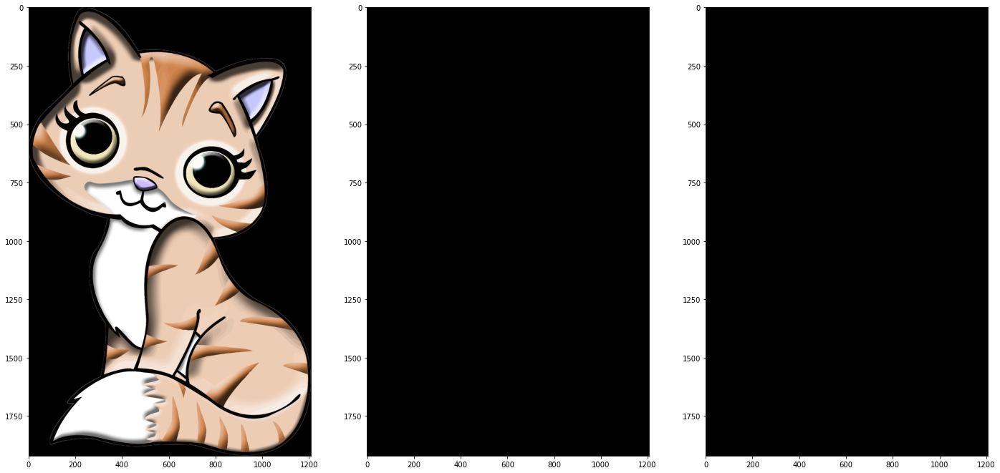

In [183]:
masked_img1 = cv2.bitwise_xor(img, img, mask=mask1)
masked_img2 = cv2.bitwise_xor(img, img, mask=mask2)

plt.figure(figsize=[24,15])
plt.subplot(131); plt.imshow(img)
# plt.subplot(132); plt.imshow(mask1)
# plt.subplot(133); plt.imshow(mask2)
plt.subplot(132); plt.imshow(masked_img1)
plt.subplot(133); plt.imshow(masked_img2)

In [184]:
mask = np.zeros(img.shape[:2], dtype=np.uint8)

cv2.rectangle(mask, (100, 100), (500, 700), 255, -1)

inv_mask = cv2.bitwise_not(mask)

masked_img1 = cv2.bitwise_and(img, img, mask=mask)
masked_img2 = cv2.bitwise_and(img, img, mask=inv_mask)

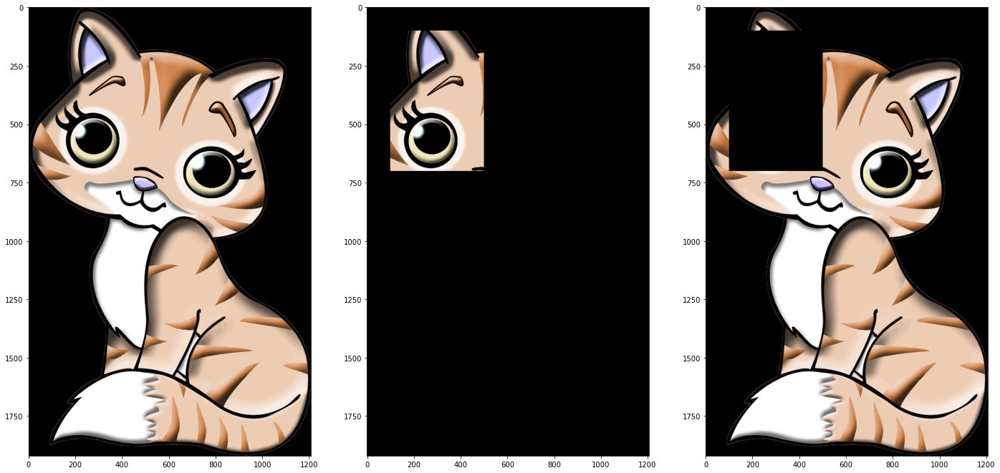

In [185]:
plt.figure(figsize=[24,15])
plt.subplot(131); plt.imshow(img)
plt.subplot(132); plt.imshow(masked_img1)
plt.subplot(133); plt.imshow(masked_img2)

In [189]:
mask1 = np.zeros(img.shape[:2], dtype=np.uint8)
mask2 = np.zeros(img.shape[:2], dtype=np.uint8)

cv2.circle(mask1, (200, 200), 100, 0, -1)
cv2.circle(mask2, (400, 200), 100, 0, -1)

masked_img = cv2.bitwise_xor(masked_img1, masked_img2)

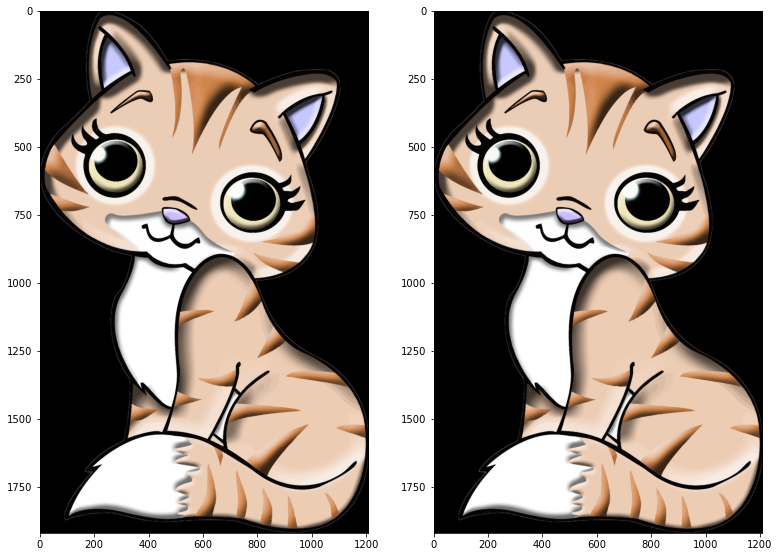

In [190]:
plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img)
plt.subplot(132); plt.imshow(masked_img)

In [213]:
img1 = cv2.imread('cat1.png', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg', cv2.IMREAD_GRAYSCALE)

In [214]:
img1.shape

(1920, 1207)

In [215]:
img2 = cv2.resize(img2, dsize=(1920, 1207), interpolation=cv2.INTER_AREA)

In [222]:
mask = np.zeros(img1.shape[:2], img.dtype) 

In [223]:
cv2.rectangle(mask, (100, 100), (300, 300), 255, -1)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [224]:
masked_img1 = cv2.bitwise_and(img1, img1, mask=mask)
inv_mask = cv2.bitwise_not(mask)

In [225]:
inv_mask.shape

(1920, 1207)

In [226]:
masked_img2 = cv2.bitwise_and(img2, img2, mask=inv_mask)

error: OpenCV(4.7.0) /Users/runner/work/opencv-python/opencv-python/opencv/modules/core/src/arithm.cpp:230: error: (-215:Assertion failed) (mtype == CV_8U || mtype == CV_8S) && _mask.sameSize(*psrc1) in function 'binary_op'


In [227]:
bitwise_or = cv2.bitwise_or(masked_img1, masked_img2)

error: OpenCV(4.7.0) /Users/runner/work/opencv-python/opencv-python/opencv/modules/core/src/arithm.cpp:214: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and type), nor 'array op scalar', nor 'scalar op array' in function 'binary_op'


In [228]:
img1.shape, img2.shape

((1920, 1207), (1207, 1920))

In [235]:
mask1 = np.zeros(img1.shape[:2], dtype=np.uint8)
mask2 = np.zeros(img2.shape[:2], dtype=np.uint8)

cv2.circle(mask1, (200, 200), 500, 255, -1)
cv2.circle(mask2, (400, 200), 650, 255, -1)

array([[255, 255, 255, ...,   0,   0,   0],
       [255, 255, 255, ...,   0,   0,   0],
       [255, 255, 255, ...,   0,   0,   0],
       ...,
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0]], dtype=uint8)

In [236]:
masked_img1 = cv2.bitwise_and(img1, img1, mask=mask1)
masked_img2 = cv2.bitwise_and(img2, img2, mask=mask2)

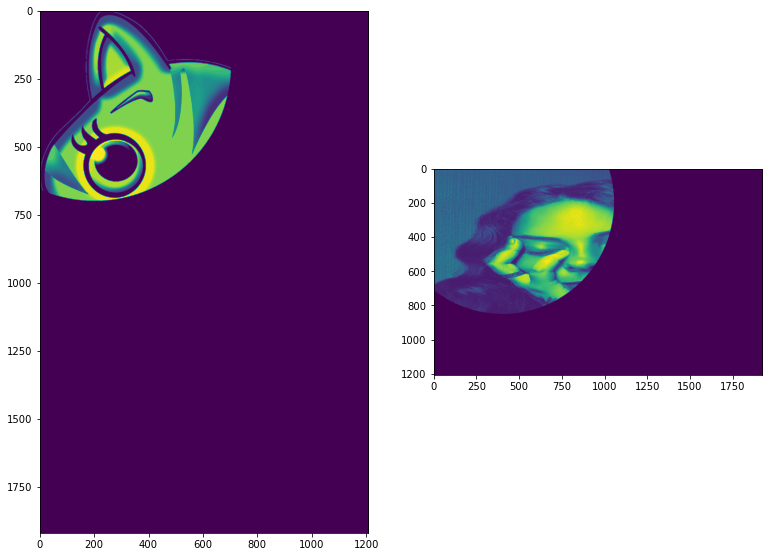

In [237]:
plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(masked_img1)
plt.subplot(132); plt.imshow(masked_img2)

# Noise

Salt and pepper noise

In [251]:
img1 = cv2.imread('cat1.png', 1) # [:,:,-1]
img2 = cv2.imread('/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg', 1)

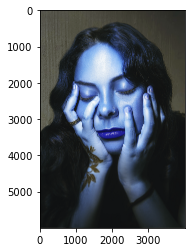

In [252]:
plt.imshow(img2)

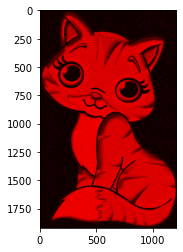

In [247]:
noise = np.zeros_like(img1)
cv2.randu(noise, 0, 255)
black = noise < 10
white = noise > 245
img1[black] = 0
img1[white] = 255
plt.imshow(img1)

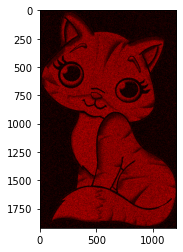

In [248]:
noise = np.zeros_like(img1)
cv2.randu(noise, 0, 255)
black = noise < 100
white = noise > 245
img1[black] = 0
img1[white] = 255
plt.imshow(img1)

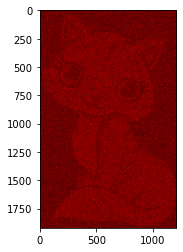

In [249]:
noise = np.zeros_like(img1)
cv2.randu(noise, 0, 255)
black = noise < 100
white = noise > 150
img1[black] = 0
img1[white] = 255
plt.imshow(img1)

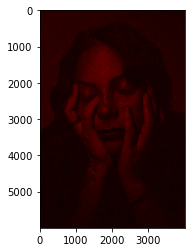

In [254]:
noise = np.zeros_like(img2)
cv2.randu(noise, 0, 255)
black = noise < 100
white = noise > 245
img2[black] = 0
img2[white] = 255
plt.imshow(img2)

In [256]:
img1 = cv2.imread('cat1.png', 1) # [:,:,-1]
img2 = cv2.imread('/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg', 1)

Speckle noise

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


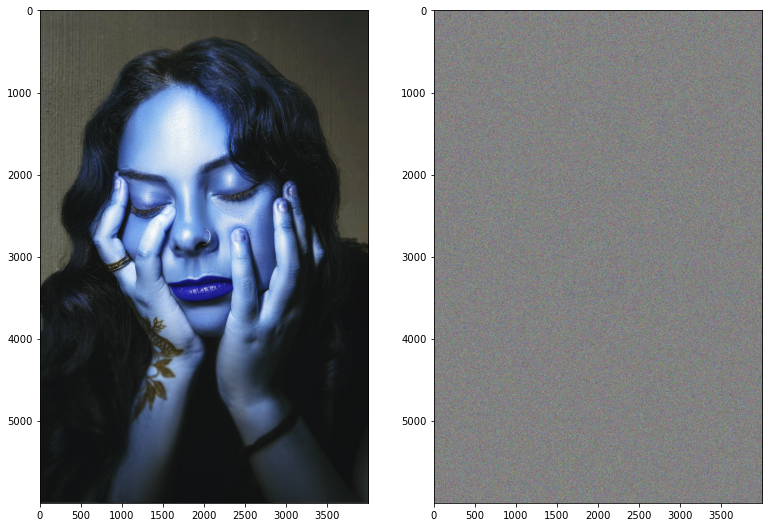

In [263]:
noise = np.random.randn(*img2.shape) * 50
noisy_img = img2 + img2 * noise
plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img2)
plt.subplot(132); plt.imshow(noisy_img)

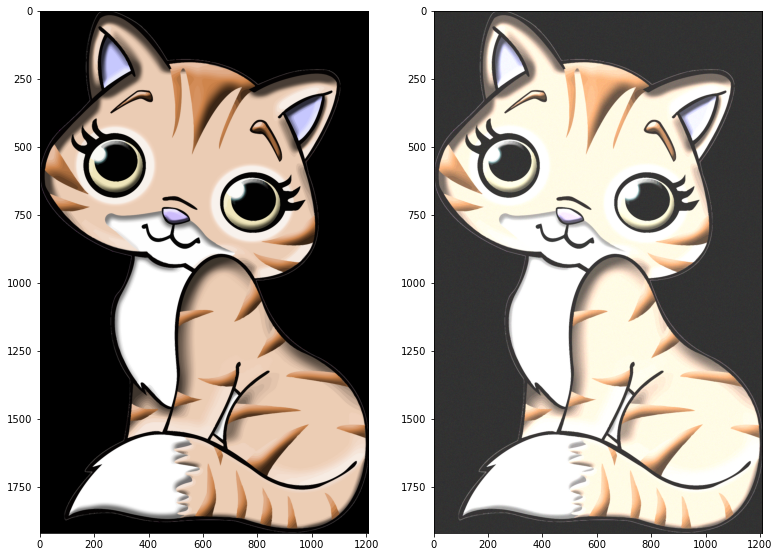

In [265]:
lam = 50
noise = np.random.poisson(lam, img1.shape).astype(np.float32)
noisy_img = np.clip(img1 + noise, 0, 255).astype(np.uint8)
plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img1)
plt.subplot(132); plt.imshow(noisy_img)

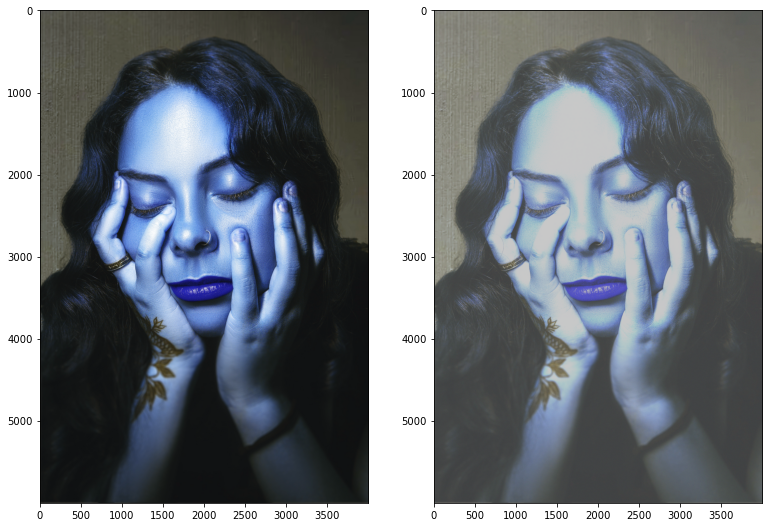

In [266]:
lam = 50
noise = np.random.poisson(lam, img2.shape).astype(np.float32)
noisy_img = np.clip(img2 + noise, 50, 200).astype(np.uint8)
plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img2)
plt.subplot(132); plt.imshow(noisy_img)

Periodic noise

In [268]:
img1 = cv2.imread('cat1.png', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg', cv2.IMREAD_GRAYSCALE)

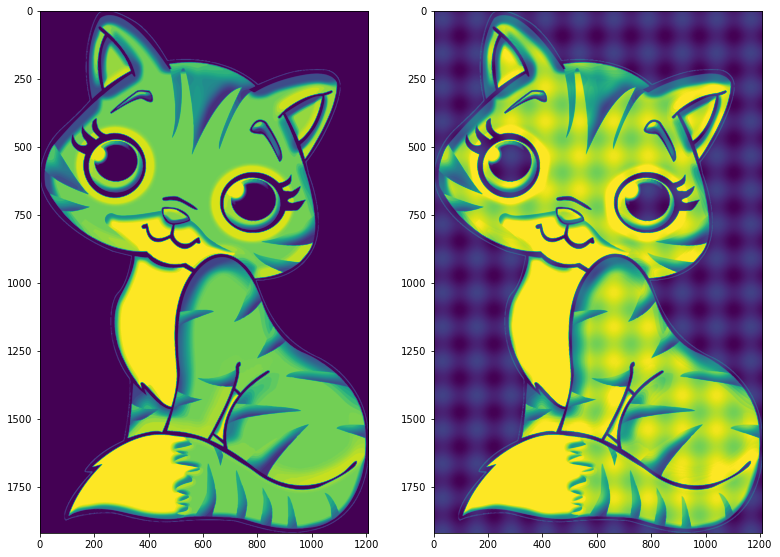

In [269]:
period = 20  
x = np.arange(img1.shape[1])
y = np.arange(img1.shape[0])
xx, yy = np.meshgrid(x, y)
noise = np.sin(xx / period) + np.sin(yy / period)

noise -= noise.min()
noise /= noise.max()

noisy_img = np.clip(img1 + noise * 50, 0, 255).astype(np.uint8)
plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img1)
plt.subplot(132); plt.imshow(noisy_img)

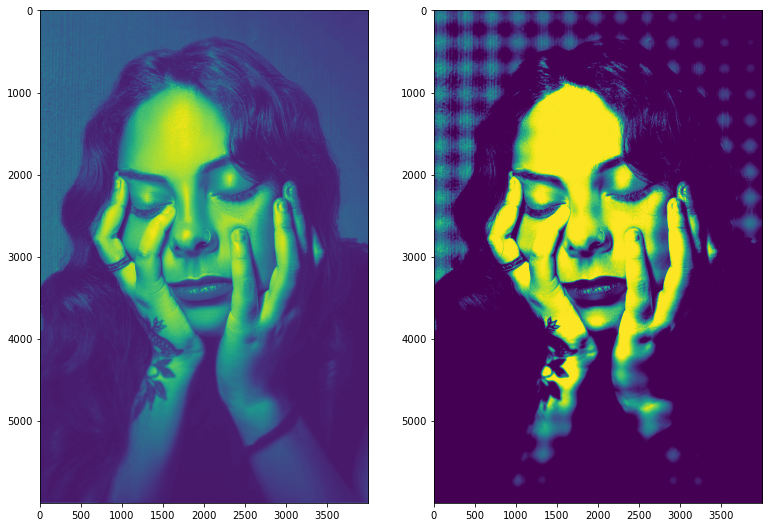

In [271]:
period = 50
x = np.arange(img2.shape[1])
y = np.arange(img2.shape[0])
xx, yy = np.meshgrid(x, y)
noise = np.sin(xx / period) + np.sin(yy / period)

noise -= noise.min()
noise /= noise.max()

noisy_img = np.clip(img2 + noise * 50, 90, 180).astype(np.uint8)
plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img2)
plt.subplot(132); plt.imshow(noisy_img)

Quantization noise

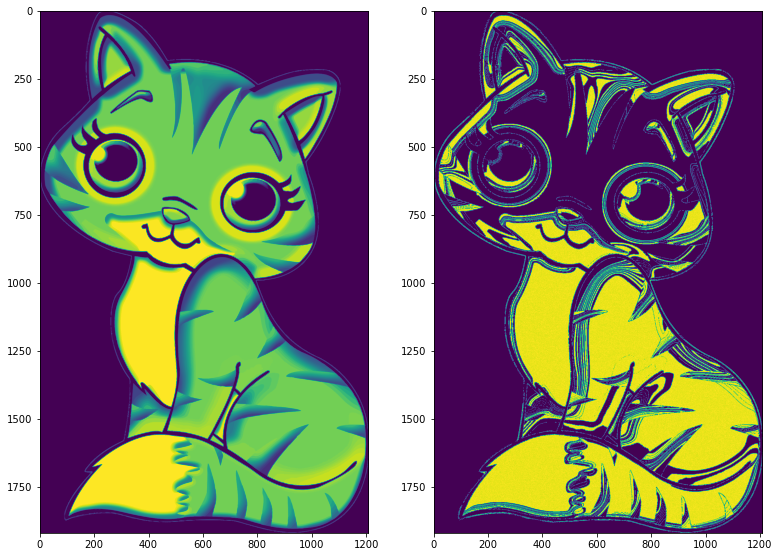

In [272]:
bits = 4
levels = 2 ** bits
quantized_img = np.round(levels * img1 / 256) * (256 / levels)

noise = np.random.uniform(-0.5, 0.5, img1.shape)
noisy_img = np.clip(quantized_img + noise, 0, 255).astype(np.uint8)
plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img1)
plt.subplot(132); plt.imshow(noisy_img)

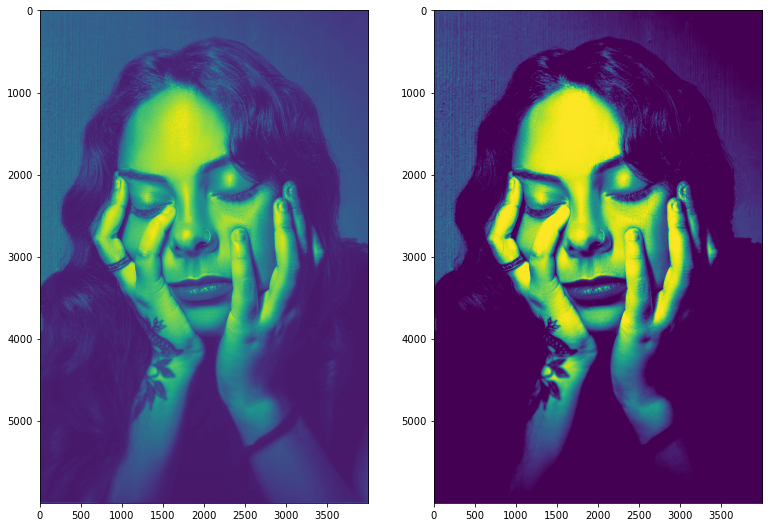

In [274]:
bits = 8
levels = 2 ** bits
quantized_img = np.round(levels * img2 / 256) * (256 / levels)

noise = np.random.uniform(-0.5, 0.5, img2.shape)
noisy_img = np.clip(quantized_img + noise, 50, 200).astype(np.uint8)
plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img2)
plt.subplot(132); plt.imshow(noisy_img)

## Edge detection

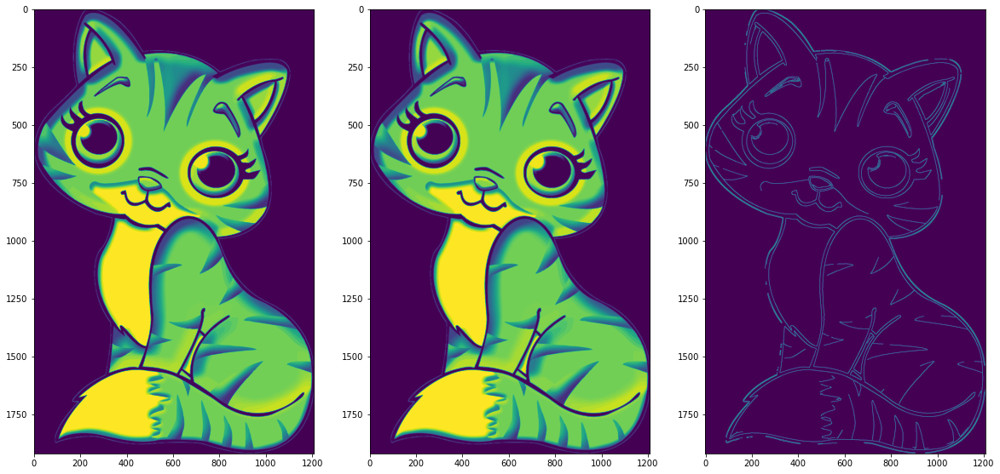

In [279]:
blurred = cv2.GaussianBlur(img1, (3, 3), 0)
edges_default = cv2.Canny(blurred, 100, 200)
edges_custom = cv2.Canny(blurred, 50, 150)
edges_5 = cv2.Canny(blurred, 100, 200, apertureSize=5)
edges_l2grad = cv2.Canny(blurred, 100, 200, L2gradient=True)

plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img1)
plt.subplot(132); plt.imshow(blurred)
plt.subplot(133); plt.imshow(edges_default)
# plt.subplot(134); plt.imshow(edges_custom)
# plt.subplot(135); plt.imshow(edges_5)
# plt.subplot(131); plt.imshow(edges_l2grad)

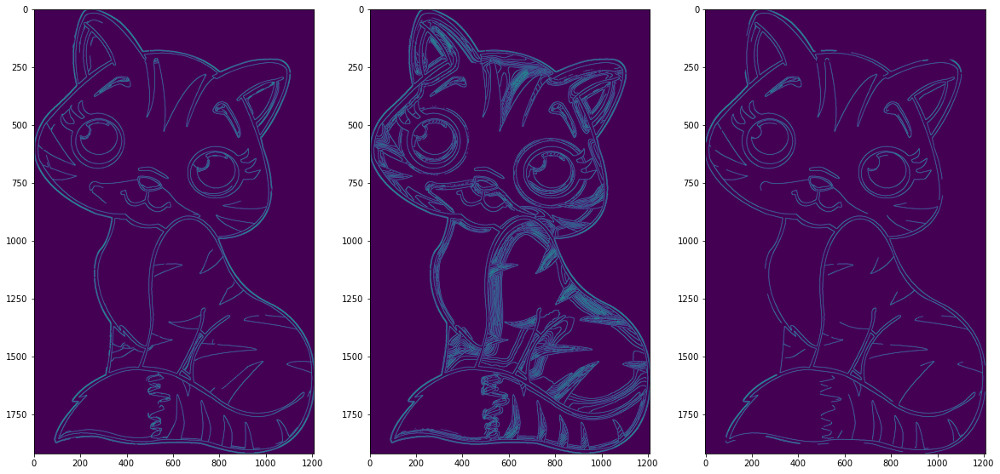

In [278]:
plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(edges_custom)
plt.subplot(132); plt.imshow(edges_5)
plt.subplot(133); plt.imshow(edges_l2grad)

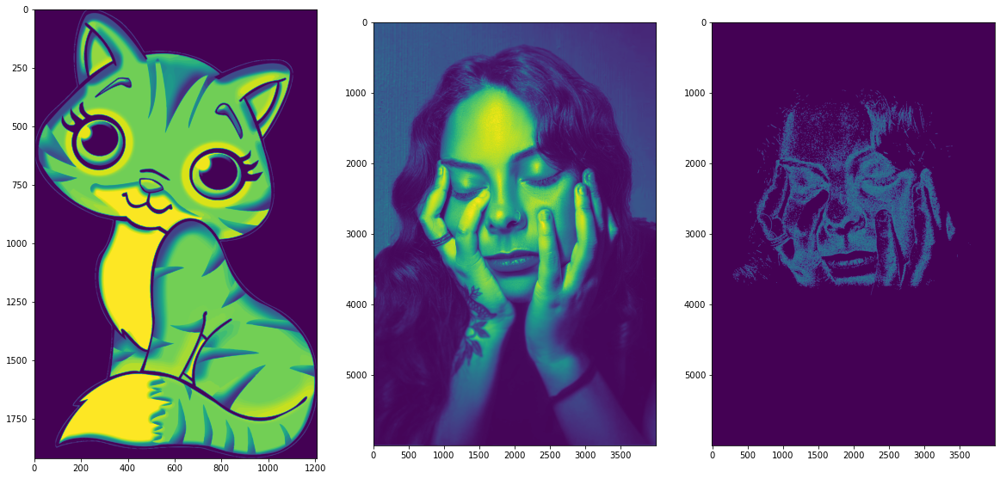

In [280]:
blurred = cv2.GaussianBlur(img2, (3, 3), 0)
edges_default = cv2.Canny(blurred, 100, 200)
edges_custom = cv2.Canny(blurred, 50, 150)
edges_5 = cv2.Canny(blurred, 100, 200, apertureSize=5)
edges_l2grad = cv2.Canny(blurred, 100, 200, L2gradient=True)

plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img1)
plt.subplot(132); plt.imshow(blurred)
plt.subplot(133); plt.imshow(edges_default)
# plt.subplot(134); plt.imshow(edges_custom)
# plt.subplot(135); plt.imshow(edges_5)
# plt.subplot(131); plt.imshow(edges_l2grad)

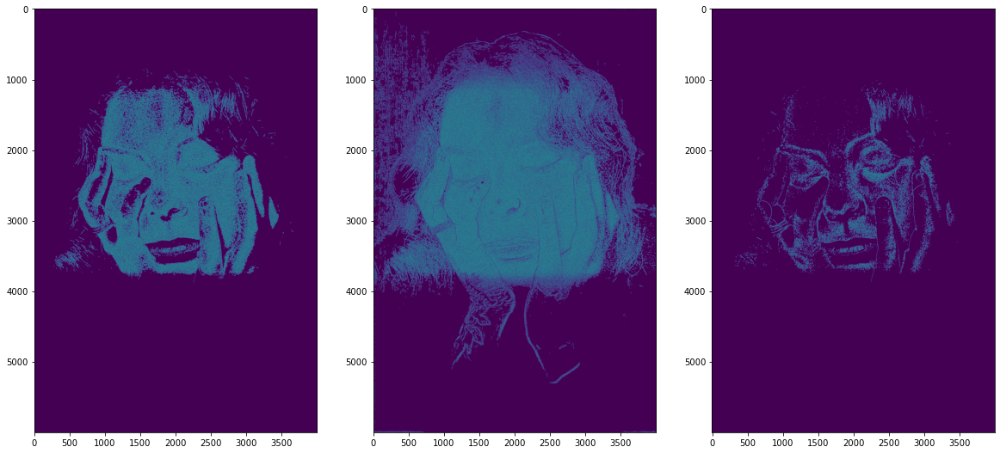

In [281]:
plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(edges_custom)
plt.subplot(132); plt.imshow(edges_5)
plt.subplot(133); plt.imshow(edges_l2grad)

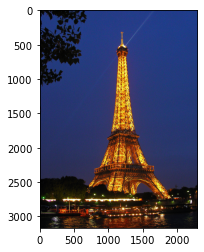

In [289]:
img2 = cv2.imread('/Users/saruul/Desktop/openCV/eiffel_tower_france_paris.jpg',1)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
plt.imshow(img2)

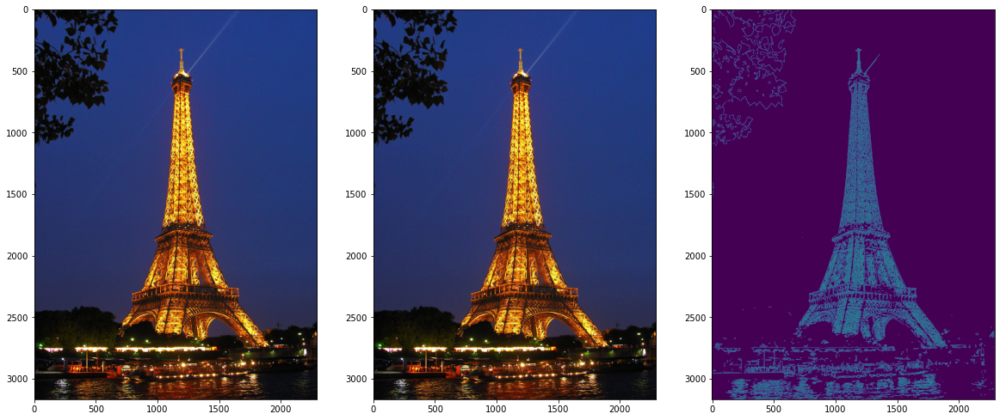

In [291]:
blurred = cv2.GaussianBlur(img2, (3, 3), 0)
edges_default = cv2.Canny(blurred, 100, 200)
edges_custom = cv2.Canny(blurred, 50, 150)
edges_5 = cv2.Canny(blurred, 100, 200, apertureSize=5)
edges_l2grad = cv2.Canny(blurred, 100, 200, L2gradient=True)

plt.figure(figsize=[20,12])
plt.subplot(131); plt.imshow(img2)
plt.subplot(132); plt.imshow(blurred)
plt.subplot(133); plt.imshow(edges_default)
# plt.subplot(134); plt.imshow(edges_custom)
# plt.subplot(135); plt.imshow(edges_5)
# plt.subplot(131); plt.imshow(edges_l2grad)

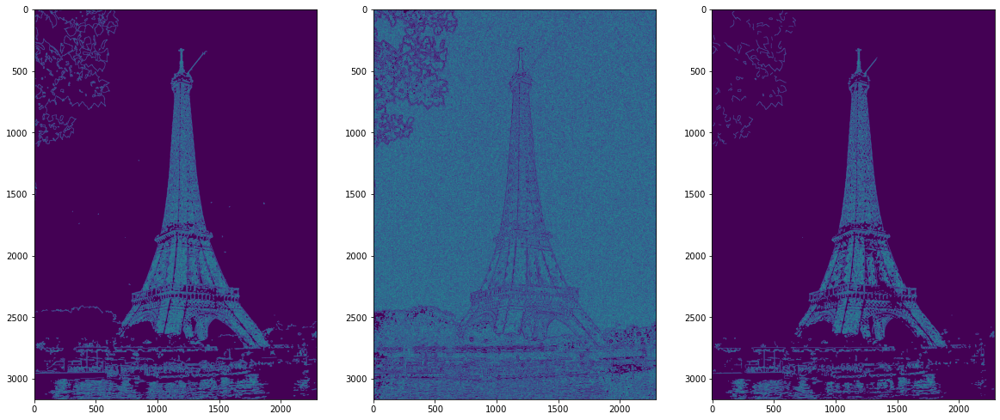

In [292]:
plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(edges_custom)
plt.subplot(132); plt.imshow(edges_5)
plt.subplot(133); plt.imshow(edges_l2grad)

Laplacian of Gaussian (LoG) method

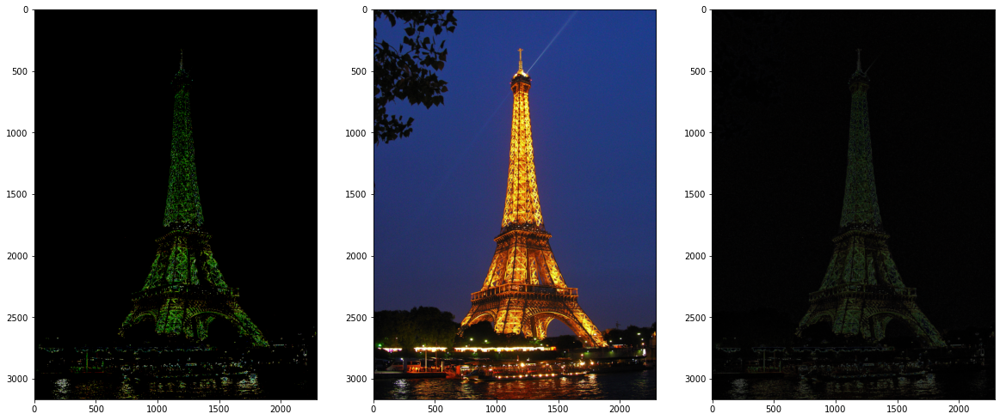

In [296]:
blurred = cv2.GaussianBlur(img2, (3, 3), 0)

edges = cv2.Laplacian(blurred, cv2.CV_64F)
edges = np.uint8(np.absolute(edges))
thresh = cv2.threshold(edges, 50, 255, cv2.THRESH_BINARY)[1]

plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(thresh)
plt.subplot(132); plt.imshow(blurred)
plt.subplot(133); plt.imshow(edges)

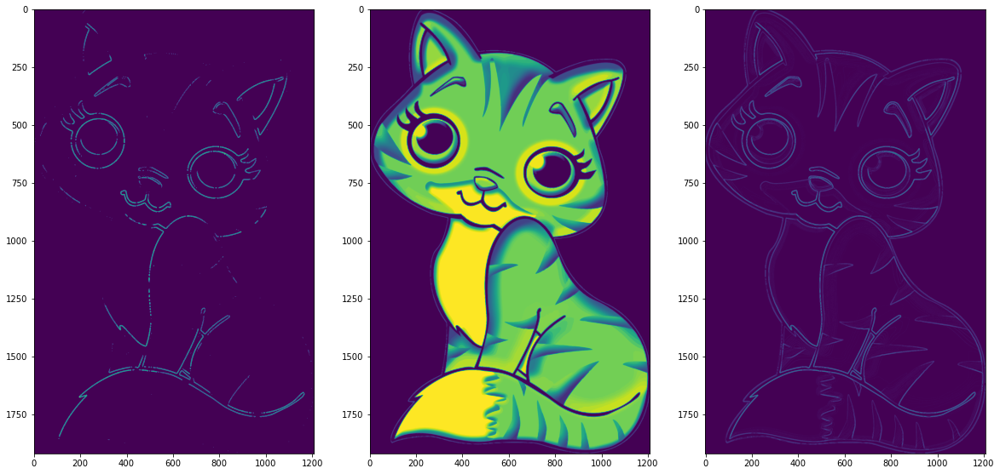

In [297]:
blurred = cv2.GaussianBlur(img1, (3, 3), 0)

edges = cv2.Laplacian(blurred, cv2.CV_64F)
edges = np.uint8(np.absolute(edges))
thresh = cv2.threshold(edges, 50, 255, cv2.THRESH_BINARY)[1]

plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(thresh)
plt.subplot(132); plt.imshow(blurred)
plt.subplot(133); plt.imshow(edges)

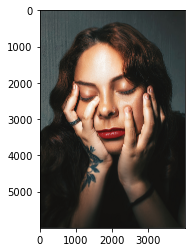

In [298]:
img2 = cv2.imread('/Users/saruul/Desktop/openCV/pexels-jhon-ferreira-15270018.jpg', 1)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
plt.imshow(img2)

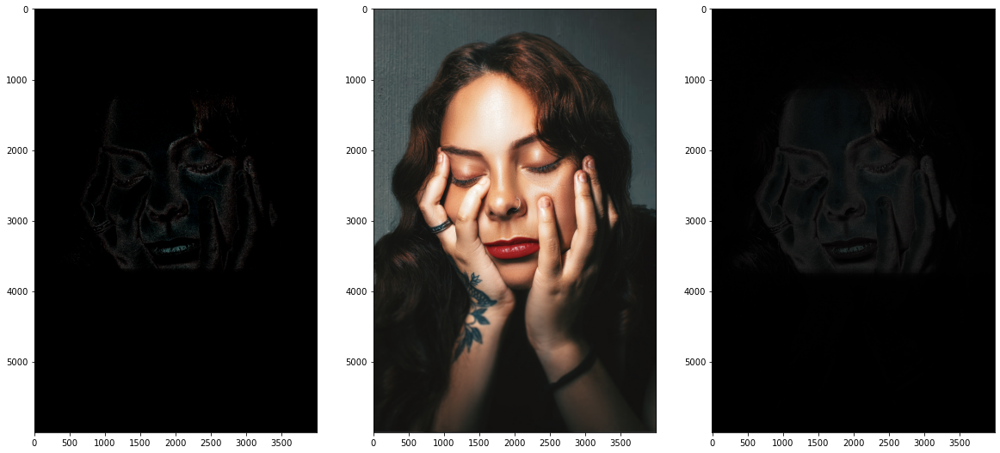

In [300]:
blurred = cv2.GaussianBlur(img2, (3, 3), 0)

edges = cv2.Laplacian(blurred, cv2.CV_64F)
edges = np.uint8(np.absolute(edges))
thresh = cv2.threshold(edges, 50, 200, cv2.THRESH_BINARY)[1]

plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(thresh)
plt.subplot(132); plt.imshow(blurred)
plt.subplot(133); plt.imshow(edges)

Sobel operator

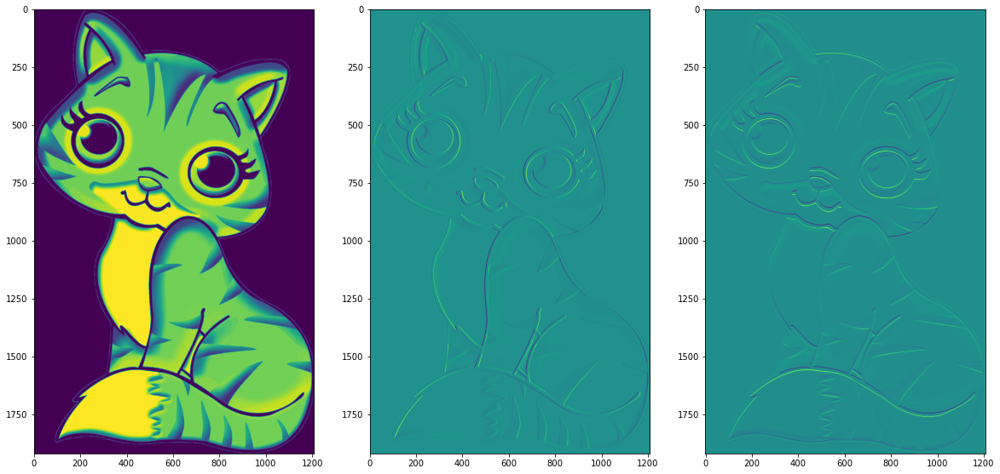

In [304]:
blurred = cv2.GaussianBlur(img1, (3, 3), 0)

sobelx = cv2.Sobel(blurred, cv2.CV_64F, 1, 0, ksize=3)
sobely = cv2.Sobel(blurred, cv2.CV_64F, 0, 1, ksize=3)

grad_mag = np.sqrt(sobelx ** 2 + sobely ** 2)
grad_dir = np.arctan2(sobely, sobelx)

thresh = cv2.threshold(grad_mag, 50, 255, cv2.THRESH_BINARY)[1]

plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(blurred)
plt.subplot(132); plt.imshow(sobelx)
plt.subplot(133); plt.imshow(sobely)

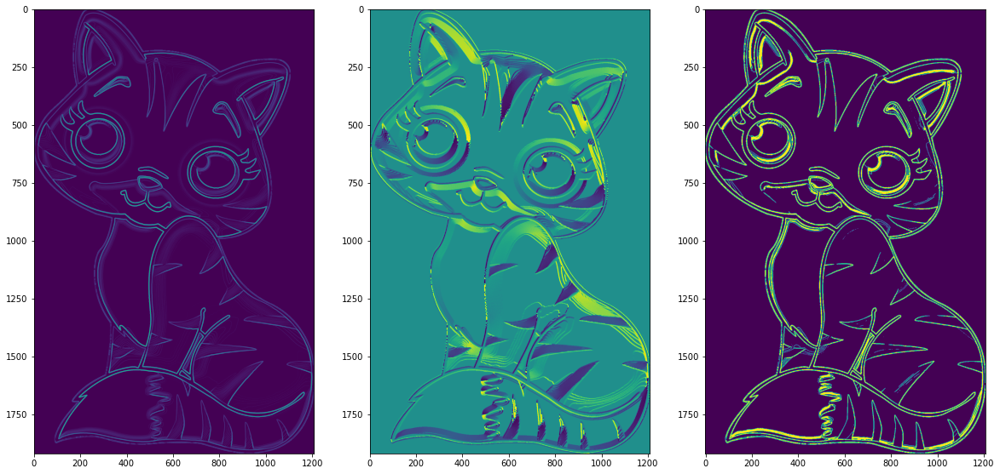

In [303]:
plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(grad_mag)
plt.subplot(132); plt.imshow(grad_dir)
plt.subplot(133); plt.imshow(thresh)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


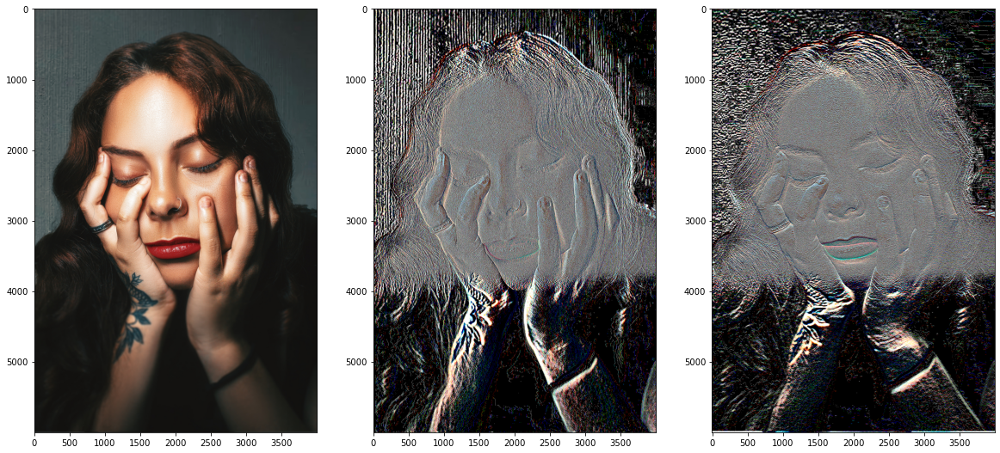

In [305]:
blurred = cv2.GaussianBlur(img2, (3, 3), 0)

sobelx = cv2.Sobel(blurred, cv2.CV_64F, 1, 0, ksize=3)
sobely = cv2.Sobel(blurred, cv2.CV_64F, 0, 1, ksize=3)

grad_mag = np.sqrt(sobelx ** 2 + sobely ** 2)
grad_dir = np.arctan2(sobely, sobelx)

thresh = cv2.threshold(grad_mag, 50, 255, cv2.THRESH_BINARY)[1]

plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(blurred)
plt.subplot(132); plt.imshow(sobelx)
plt.subplot(133); plt.imshow(sobely)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


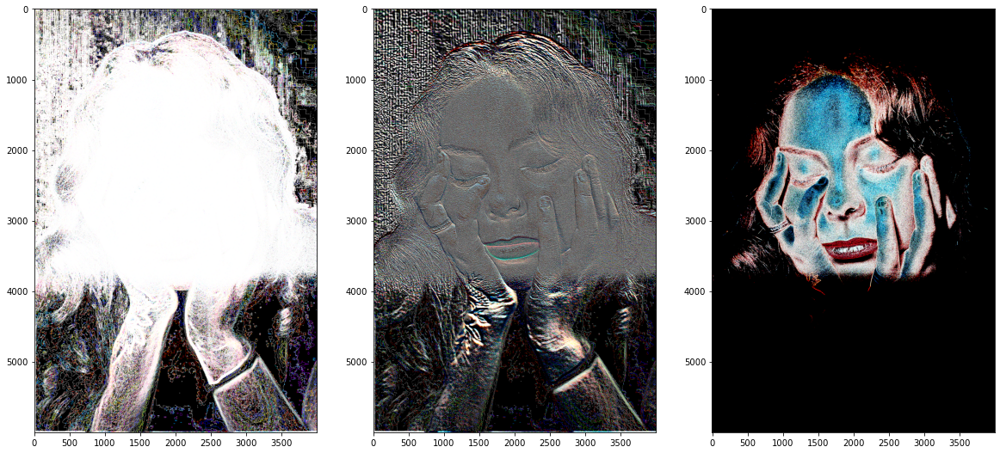

In [306]:
plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(grad_mag)
plt.subplot(132); plt.imshow(grad_dir)
plt.subplot(133); plt.imshow(thresh)

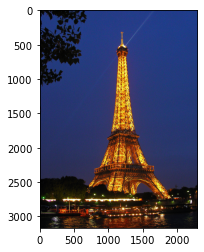

In [307]:
img2 = cv2.imread('/Users/saruul/Desktop/openCV/eiffel_tower_france_paris.jpg',1)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
plt.imshow(img2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


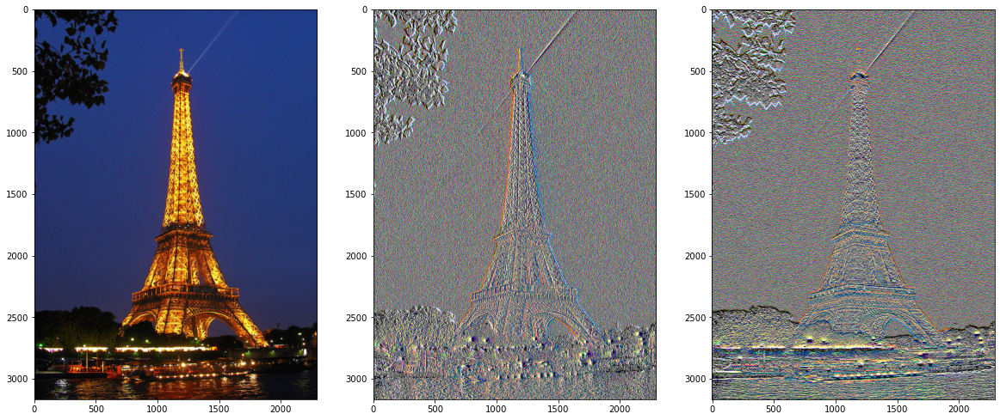

In [308]:
blurred = cv2.GaussianBlur(img2, (3, 3), 0)

sobelx = cv2.Sobel(blurred, cv2.CV_64F, 1, 0, ksize=3)
sobely = cv2.Sobel(blurred, cv2.CV_64F, 0, 1, ksize=3)

grad_mag = np.sqrt(sobelx ** 2 + sobely ** 2)
grad_dir = np.arctan2(sobely, sobelx)

thresh = cv2.threshold(grad_mag, 50, 255, cv2.THRESH_BINARY)[1]

plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(blurred)
plt.subplot(132); plt.imshow(sobelx)
plt.subplot(133); plt.imshow(sobely)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


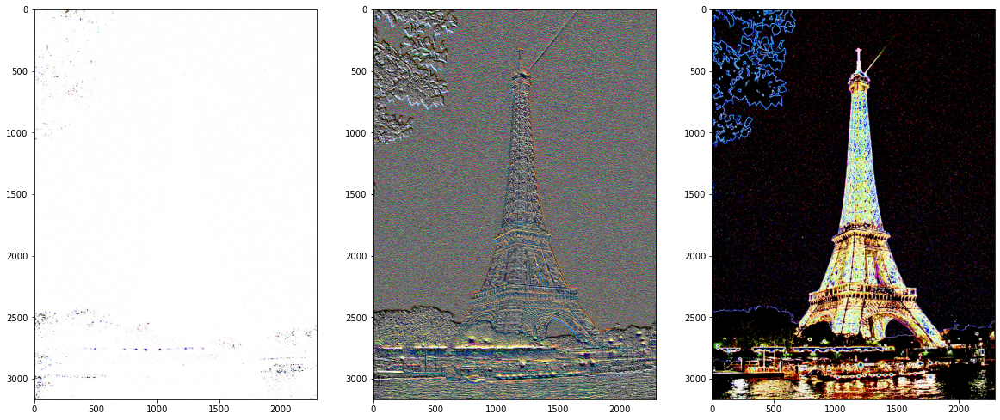

In [309]:
plt.figure(figsize=[20,12])
# plt.subplot(131); plt.imshow(img1)
# plt.subplot(132); plt.imshow(blurred)
# plt.subplot(133); plt.imshow(edges_default)
plt.subplot(131); plt.imshow(grad_mag)
plt.subplot(132); plt.imshow(grad_dir)
plt.subplot(133); plt.imshow(thresh)